In [27]:
import os
import numpy as np
import scipy

In [28]:
import matplotlib.pyplot as plt

In [29]:
info_dict = {
    '1221': {
        'name': 'Sourish',
        'did_meditation_first': True,
        'did_ACS': True,
    },
    '1222': {
        'name': 'Caleb',
        'did_meditation_first': False,
        'did_ACS': True,
    },
    '1223': {
        'name': 'Charlotte',
        'did_meditation_first': True,
        'did_ACS': False,
    },
    '1224': {
        'name': 'Aditya',
        'did_meditation_first': False,
        'did_ACS': True,
    },
}

In [30]:
def get_folder_name(eeg_data, day_number):
    if eeg_data == 'eyes_closed_rest_to_get_target_frequency':
        return 'ses-S00' + day_number + 'ec'
    elif eeg_data == 'eog_calibration':
        return 'ses-S00' + day_number + 'eog'
    elif eeg_data == 'nback_before_stim':
        return 'ses-S00' + day_number + 'N2pre'
    elif eeg_data == 'eyes_closed_before_stim':
        return 'ses-S00' + day_number + 'ecpre'
    elif eeg_data == 'relaxation_data':
        return 'ses-S00' + day_number + 'r'
    elif eeg_data == 'eyes_closed_after_stim':
        return 'ses-S00' + day_number + 'ecpost'
    elif eeg_data == 'nback_after_stim':
        return 'ses-S00' + day_number + 'N2post'
    elif eeg_data == 'eyes_closed_before_control':
        return 'ses-S00' + day_number + 'ecpren'
    elif eeg_data == 'eyes_closed_after_control':
        return 'ses-S00' + day_number + 'ecpostn'
    elif eeg_data == 'eyes_closed_during_control':
        return 'ses-S00' + day_number + 'n'

def get_relevant_data(subject, request_type):
    day_type = request_type[0]
    eeg_data = request_type[1]
    assert day_type in ['ACS', 'meditation']
    assert eeg_data in ['eyes_closed_rest_to_get_target_frequency', 'eog_calibration', 'nback_before_stim', 'eyes_closed_before_stim', 'relaxation_data', 'eyes_closed_after_stim', 'nback_after_stim', 'eyes_closed_before_control', 'eyes_closed_after_control', 'eyes_closed_during_control']
    if day_type == 'ACS':
        day_number = 2 if info_dict[subject]['did_meditation_first'] else 1
    elif day_type == 'meditation':
        day_number = 1 if info_dict[subject]['did_meditation_first'] else 2
    day_number = str(day_number)
    
    folder_name = get_folder_name(eeg_data, day_number)
    # print(os.listdir('data/Group 12/sub-P1221/ses-S002ec/'))
    look_up_table = {
        'sub-P1221/ses-S002ec': 'sub-P1221/ses-S002eo',
        'sub-P1221/ses-S002n': 'sub-P1221/ses-S002ecn',
        'sub-P1221/ses-S001ecpost': 'sub-P1221/ses-S001ecpostACS',
        'sub-P1223/ses-S001ecpre': 'sub-P1223/ses-S001ecprer',
        'sub-P1224/ses-S001ec': 'sub-P1224/ses-S001ecfindtACS',
        'sub_P1224/ses-S001ecpost': 'sub_P1224/ses-S001ecpostACS',
        'sub-P1221/ses-S002ecpre': 'sub-P1221/ses-S002pretACS',
        'sub-P1222/ses-S001ecpre': 'sub-P1222/ses-S001postn',
        'sub-P1224/ses-S001ecpre': 'sub-P1224/ses-S001ecfindtACS',
        'sub-P1221/ses-S002ecpost': 'sub-P1221/ses-S002ecpostCS',
        'sub-P1222/ses-S001ecpost': 'sub-P1222/ses-S001ecpostACS',
        'sub-P1224/ses-S001ecpost': 'sub-P1224/ses-S001ecpostACS',
    }
    try:
        real_folder_name = 'data/Group 12/sub-P' + subject + '/' + folder_name  + '/eeg/'
        file_names = [real_folder_name + file for file in os.listdir(real_folder_name)]
    except Exception as e:
        real_folder_name = 'data/Group 12/' + look_up_table['sub-P' + subject + '/' + folder_name] + '/eeg/'
        file_names = [real_folder_name + file for file in os.listdir(real_folder_name)]

    
    return file_names
    

get_relevant_data('1221', ['ACS', 'eyes_closed_rest_to_get_target_frequency'])

['data/Group 12/sub-P1221/ses-S002eo/eeg/sub-P1221_ses-S002eo_task-Default_run-001_eeg.xdf']

In [31]:
all_subjects = ['1221', '1222', '1224']
all_premeditation_ec = [get_relevant_data(subject, ['meditation', 'eyes_closed_before_stim']) for subject in all_subjects]
all_postmeditation_ec = [get_relevant_data(subject, ['meditation', 'eyes_closed_after_stim']) for subject in all_subjects]

In [32]:
all_preTACS_ec = [get_relevant_data(subject, ['ACS', 'eyes_closed_before_stim']) for subject in all_subjects]
all_postTACS_ec = [get_relevant_data(subject, ['ACS', 'eyes_closed_after_stim']) for subject in all_subjects]
# data/Group 12/sub-P1221/ses-S002ecpretACS/eeg/
# data/Group 12/sub-P1221/ses-S002pretACS/eeg

In [33]:
print(all_postTACS_ec)
print(all_preTACS_ec)

[['data/Group 12/sub-P1221/ses-S002ecpostCS/eeg/sub-P1221_ses-S002ecpostCS_task-Default_run-001_eeg.xdf'], ['data/Group 12/sub-P1222/ses-S001ecpostACS/eeg/sub-P1222_ses-S001ecpostACS_task-Default_run-001_eeg.xdf'], ['data/Group 12/sub-P1224/ses-S001ecpostACS/eeg/sub-P1224_ses-S001ecpostACS_task-Default_run-001_eeg.xdf']]
[['data/Group 12/sub-P1221/ses-S002pretACS/eeg/sub-P1221_ses-S002pretACS_task-Default_run-001_eeg.xdf'], ['data/Group 12/sub-P1222/ses-S001postn/eeg/sub-P1222_ses-S001postn_task-Default_run-001_eeg.xdf'], ['data/Group 12/sub-P1224/ses-S001ecfindtACS/eeg/sub-P1224_ses-S001ecfindtACS_task-Default_run-001_eeg.xdf']]


In [34]:
print(all_premeditation_ec)

[['data/Group 12/sub-P1221/ses-S001ecpre/eeg/sub-P1221_ses-S001ecpre_task-Default_run-001_eeg.xdf'], ['data/Group 12/sub-P1222/ses-S002ecpre/eeg/sub-P1222_ses-S002ecpre_task-Default_run-001_eeg_old1.xdf', 'data/Group 12/sub-P1222/ses-S002ecpre/eeg/sub-P1222_ses-S002ecpre_task-Default_run-001_eeg.xdf'], ['data/Group 12/sub-P1224/ses-S002ecpre/eeg/sub-P1224_ses-S002ecpre_task-Default_run-001_eeg.xdf']]


In [35]:
!pip install pyxdf
from pyxdf import load_xdf


In [36]:
pre_post_meditation_subject_data = []


for subject, pre_med_ec, post_med_ec in zip(all_subjects, all_premeditation_ec, all_postmeditation_ec):
    for pre_med_file, post_med_file in zip(pre_med_ec, post_med_ec):
        pre_med_data = load_xdf(pre_med_file)
        post_med_data = load_xdf(post_med_file)
        pre_post_meditation_subject_data.append((subject, pre_med_data, post_med_data))
        print(pre_med_data)
        print(post_med_data)

pre_post_tacs_subject_data = []

for subject, pre_tacs_ec, post_tacs_ec in zip(all_subjects, all_preTACS_ec, all_postTACS_ec):
    for pre_tacs_file, post_tacs_file in zip(pre_tacs_ec, post_tacs_ec):
        pre_tacs_data = load_xdf(pre_tacs_file)
        post_tacs_data = load_xdf(post_tacs_file)
        pre_post_tacs_subject_data.append((subject, pre_tacs_data, post_tacs_data))

([{'info': defaultdict(<class 'list'>, {'name': ['eegoSports 000613'], 'type': ['EEG'], 'channel_count': ['39'], 'channel_format': ['double64'], 'source_id': ['eegoSports_000613'], 'nominal_srate': ['512.0000000000000'], 'version': ['1.100000000000000'], 'created_at': ['72160.81796452700'], 'uid': ['ef5bc0d8-c701-43ee-8366-4d64ccf5bd98'], 'session_id': ['default'], 'hostname': ['ecen-a52211'], 'v4address': [None], 'v4data_port': ['16574'], 'v4service_port': ['16586'], 'v6address': [None], 'v6data_port': ['16575'], 'v6service_port': ['16587'], 'desc': [defaultdict(<class 'list'>, {'channels': [defaultdict(<class 'list'>, {'channel': [defaultdict(<class 'list'>, {'label': ['AF3'], 'type': ['EEG'], 'unit': ['uV']}), defaultdict(<class 'list'>, {'label': ['AF4'], 'type': ['EEG'], 'unit': ['uV']}), defaultdict(<class 'list'>, {'label': ['F3'], 'type': ['EEG'], 'unit': ['uV']}), defaultdict(<class 'list'>, {'label': ['F1'], 'type': ['EEG'], 'unit': ['uV']}), defaultdict(<class 'list'>, {'lab

In [37]:
channel_names = None
num_channels = None
def get_psd_data(data, graph = False, num_divisions = 8, noprint = True):
    global channel_names
    global num_channels
    data = data[0][0]
    info = data['info']
    eeg_data = data['time_series']
    time_stamps = data['time_stamps']
    clock_times = data['clock_times']
    clock_values = data['clock_values']
    info_name = info['name']
    sampling_rate = int(float(info['nominal_srate'][0]))
    channel_names = [info['desc'][0]['channels'][0]['channel'][i]['label'][0] for i in range(len(info['desc'][0]['channels'][0]['channel']))]
    footer = data['footer']

    if not noprint:
        print("info: ", info)
        print("info name: ", info_name)
        print("info keys: ", info.keys())
        print("eeg_data: ", eeg_data)
        print("eeg_data shape: ", eeg_data.shape)
        print("channel_names: ", channel_names)
        print("time_stamps: ", time_stamps)
        print("clock_times: ", clock_times)
        print("clock_values: ", clock_values)
        print("sampling_rate: ", sampling_rate)
        print("footer: ", footer)   
        print(data.keys())

        
        print("channel_wise_eeg shape: ", channel_wise_eeg.shape)
        print("channel_wise_eeg: ", channel_wise_eeg)

    channel_wise_eeg = np.array(eeg_data).T

    if graph:
        plt.figure(figsize=(12,64))

    feature_powers = dict()
    num_channels = len(channel_names)

    banned_channel = lambda x: x.startswith('AUX') 

    for i, (channel_name, channel_data) in enumerate(zip(channel_names, channel_wise_eeg)):
        if banned_channel(channel_name):
            continue
        # divide the data into num_divisions
        channel_data = np.array_split(channel_data, num_divisions)
        feature_powers[channel_name] = []
        for j, channel_data_part in enumerate(channel_data):
            if graph:
                ax = plt.subplot(num_channels, num_divisions, i*num_divisions + j+1)
            freqs, pxx = scipy.signal.welch(channel_data_part, fs=sampling_rate, nperseg=1024)
            pxx = 20*np.log10(pxx)
            if graph:
                ax.plot(freqs, pxx)
                ax.set_title(channel_name)

            feature_powers[channel_name].append((freqs, pxx))
    if graph:
        plt.legend()
        plt.show()

    return feature_powers
    






In [38]:
SUBJECT_NUMBER = 2

In [39]:

meditation_feature_powers_pre = get_psd_data(pre_post_meditation_subject_data[SUBJECT_NUMBER][1])
meditation_feature_powers_post = get_psd_data(pre_post_meditation_subject_data[SUBJECT_NUMBER][2])

tacs_feature_powers_pre = get_psd_data(pre_post_tacs_subject_data[SUBJECT_NUMBER][1])
tacs_feature_powers_post = get_psd_data(pre_post_tacs_subject_data[SUBJECT_NUMBER][2])



/var/folders/72/6g3kz13d2kn7rsgx3thlz_700000gn/T/ipykernel_22712/1450099954.py:55: RuntimeWarning: divide by zero encountered in log10
  pxx = 20*np.log10(pxx)


for k in range(8):
    plt.figure(figsize=(12,64))

    for i, channel_name in enumerate(channel_names):
        ax = plt.subplot(num_channels, 7, i+1)  # Changed to 2 columns
        
        # Plot pre data
        freqs_pre, pxx_pre = meditation_feature_powers_pre[channel_name][k]
        ax.plot(freqs_pre, pxx_pre, label='Pre', color='blue')
        
        # Plot post data
        freqs_post, pxx_post = meditation_feature_powers_post[channel_name][k]
        ax.plot(freqs_post, pxx_post, label='Post', color='red')
        
        ax.set_title(channel_name)
        ax.legend()

    plt.tight_layout()
    plt.show()


for k in range(8):
    plt.figure(figsize=(12,64))

    for i, channel_name in enumerate(channel_names):
        ax = plt.subplot(num_channels, 7, i+1)
        
        # Get pre and post data
        freqs_pre, pxx_pre = meditation_feature_powers_pre[channel_name][k]
        freqs_post, pxx_post = meditation_feature_powers_post[channel_name][k]
        
        # Calculate difference (post - pre)
        pxx_diff = pxx_post - pxx_pre
        
        # Plot difference
        ax.plot(freqs_pre, pxx_diff, label='Post - Pre', color='green')
        
        ax.set_title(channel_name)
        ax.legend()
        ax.axhline(y=0, color='black', linestyle='--')  # Add zero line for reference

    plt.tight_layout()
    plt.show()


In [40]:
frequency_bands = {
    'delta_low': (0, 2),
    'delta_high': (2, 4),
    'theta': (4, 8),
    'alpha_low': (8, 10),
    'alpha_high': (10, 12),
    'beta_low': (12, 20),
    'beta_high': (20, 30),
    'gamma_low': (30, 45),
    'gamma_high': (45, 100)
}

In [41]:
def turn_into_power_bands(feature_powers):

    feature_powers = feature_powers.copy()
    for channel_name in feature_powers.keys():
        channel_feature_powers = feature_powers[channel_name]
        feature_powers[channel_name] = {}
        for band in frequency_bands.keys():
            feature_powers[channel_name][band] = []
        for k in range(len(channel_feature_powers)):
            print(channel_feature_powers[k])
            freqs, pxx = channel_feature_powers[k]
            
            for band, (low, high) in frequency_bands.items():
                mask = (freqs >= low) & (freqs <= high)
                power_band = np.sum(pxx[mask])
                feature_powers[channel_name][band].append(power_band)
    return feature_powers


In [42]:
def calculate_mean_stddev_in_power_bands(feature_powers):
    for channel_name in feature_powers.keys():
        for band in frequency_bands.keys():
            feature_powers[channel_name][band] = np.mean(feature_powers[channel_name][band]), np.std(feature_powers[channel_name][band])
    return feature_powers

In [43]:
def do_it_to_them(feature_powers):
    
    feature_powers = turn_into_power_bands(feature_powers)
    feature_powers = calculate_mean_stddev_in_power_bands(feature_powers)
    return feature_powers

In [44]:
print(meditation_feature_powers_pre)

{'AF3': [(array([  0. ,   0.5,   1. ,   1.5,   2. ,   2.5,   3. ,   3.5,   4. ,
         4.5,   5. ,   5.5,   6. ,   6.5,   7. ,   7.5,   8. ,   8.5,
         9. ,   9.5,  10. ,  10.5,  11. ,  11.5,  12. ,  12.5,  13. ,
        13.5,  14. ,  14.5,  15. ,  15.5,  16. ,  16.5,  17. ,  17.5,
        18. ,  18.5,  19. ,  19.5,  20. ,  20.5,  21. ,  21.5,  22. ,
        22.5,  23. ,  23.5,  24. ,  24.5,  25. ,  25.5,  26. ,  26.5,
        27. ,  27.5,  28. ,  28.5,  29. ,  29.5,  30. ,  30.5,  31. ,
        31.5,  32. ,  32.5,  33. ,  33.5,  34. ,  34.5,  35. ,  35.5,
        36. ,  36.5,  37. ,  37.5,  38. ,  38.5,  39. ,  39.5,  40. ,
        40.5,  41. ,  41.5,  42. ,  42.5,  43. ,  43.5,  44. ,  44.5,
        45. ,  45.5,  46. ,  46.5,  47. ,  47.5,  48. ,  48.5,  49. ,
        49.5,  50. ,  50.5,  51. ,  51.5,  52. ,  52.5,  53. ,  53.5,
        54. ,  54.5,  55. ,  55.5,  56. ,  56.5,  57. ,  57.5,  58. ,
        58.5,  59. ,  59.5,  60. ,  60.5,  61. ,  61.5,  62. ,  62.5,
        63

In [45]:
meditation_powers_pre = do_it_to_them(meditation_feature_powers_pre)
meditation_powers_post = do_it_to_them(meditation_feature_powers_post)

tacs_powers_pre = do_it_to_them(tacs_feature_powers_pre)
tacs_powers_post = do_it_to_them(tacs_feature_powers_post)

(array([  0. ,   0.5,   1. ,   1.5,   2. ,   2.5,   3. ,   3.5,   4. ,
         4.5,   5. ,   5.5,   6. ,   6.5,   7. ,   7.5,   8. ,   8.5,
         9. ,   9.5,  10. ,  10.5,  11. ,  11.5,  12. ,  12.5,  13. ,
        13.5,  14. ,  14.5,  15. ,  15.5,  16. ,  16.5,  17. ,  17.5,
        18. ,  18.5,  19. ,  19.5,  20. ,  20.5,  21. ,  21.5,  22. ,
        22.5,  23. ,  23.5,  24. ,  24.5,  25. ,  25.5,  26. ,  26.5,
        27. ,  27.5,  28. ,  28.5,  29. ,  29.5,  30. ,  30.5,  31. ,
        31.5,  32. ,  32.5,  33. ,  33.5,  34. ,  34.5,  35. ,  35.5,
        36. ,  36.5,  37. ,  37.5,  38. ,  38.5,  39. ,  39.5,  40. ,
        40.5,  41. ,  41.5,  42. ,  42.5,  43. ,  43.5,  44. ,  44.5,
        45. ,  45.5,  46. ,  46.5,  47. ,  47.5,  48. ,  48.5,  49. ,
        49.5,  50. ,  50.5,  51. ,  51.5,  52. ,  52.5,  53. ,  53.5,
        54. ,  54.5,  55. ,  55.5,  56. ,  56.5,  57. ,  57.5,  58. ,
        58.5,  59. ,  59.5,  60. ,  60.5,  61. ,  61.5,  62. ,  62.5,
        63. ,  63.5

/Library/Frameworks/Python.framework/Versions/3.13/lib/python3.13/site-packages/numpy/_core/_methods.py:191: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


(array([  0. ,   0.5,   1. ,   1.5,   2. ,   2.5,   3. ,   3.5,   4. ,
         4.5,   5. ,   5.5,   6. ,   6.5,   7. ,   7.5,   8. ,   8.5,
         9. ,   9.5,  10. ,  10.5,  11. ,  11.5,  12. ,  12.5,  13. ,
        13.5,  14. ,  14.5,  15. ,  15.5,  16. ,  16.5,  17. ,  17.5,
        18. ,  18.5,  19. ,  19.5,  20. ,  20.5,  21. ,  21.5,  22. ,
        22.5,  23. ,  23.5,  24. ,  24.5,  25. ,  25.5,  26. ,  26.5,
        27. ,  27.5,  28. ,  28.5,  29. ,  29.5,  30. ,  30.5,  31. ,
        31.5,  32. ,  32.5,  33. ,  33.5,  34. ,  34.5,  35. ,  35.5,
        36. ,  36.5,  37. ,  37.5,  38. ,  38.5,  39. ,  39.5,  40. ,
        40.5,  41. ,  41.5,  42. ,  42.5,  43. ,  43.5,  44. ,  44.5,
        45. ,  45.5,  46. ,  46.5,  47. ,  47.5,  48. ,  48.5,  49. ,
        49.5,  50. ,  50.5,  51. ,  51.5,  52. ,  52.5,  53. ,  53.5,
        54. ,  54.5,  55. ,  55.5,  56. ,  56.5,  57. ,  57.5,  58. ,
        58.5,  59. ,  59.5,  60. ,  60.5,  61. ,  61.5,  62. ,  62.5,
        63. ,  63.5

In [46]:
print(meditation_powers_pre)


{'AF3': {'delta_low': (np.float64(122.86138919057709), np.float64(15.417608462948658)), 'delta_high': (np.float64(70.56788680639914), np.float64(8.039891172265111)), 'theta': (np.float64(82.06987496233049), np.float64(10.143772362305524)), 'alpha_low': (np.float64(113.51815265254156), np.float64(11.339972178232813)), 'alpha_high': (np.float64(128.6250451389566), np.float64(10.430399137352955)), 'beta_low': (np.float64(-7.623941412477759), np.float64(23.60882192739649)), 'beta_high': (np.float64(-215.61392876452777), np.float64(33.55996589591902)), 'gamma_low': (np.float64(-688.0916477312468), np.float64(148.53093977528434)), 'gamma_high': (np.float64(-3548.384780981426), np.float64(696.8055665279494))}, 'AF4': {'delta_low': (np.float64(121.345763281492), np.float64(9.24606802722012)), 'delta_high': (np.float64(67.66933384589574), np.float64(8.947083412044286)), 'theta': (np.float64(83.9586952536109), np.float64(9.447101778671406)), 'alpha_low': (np.float64(111.20816701185707), np.float

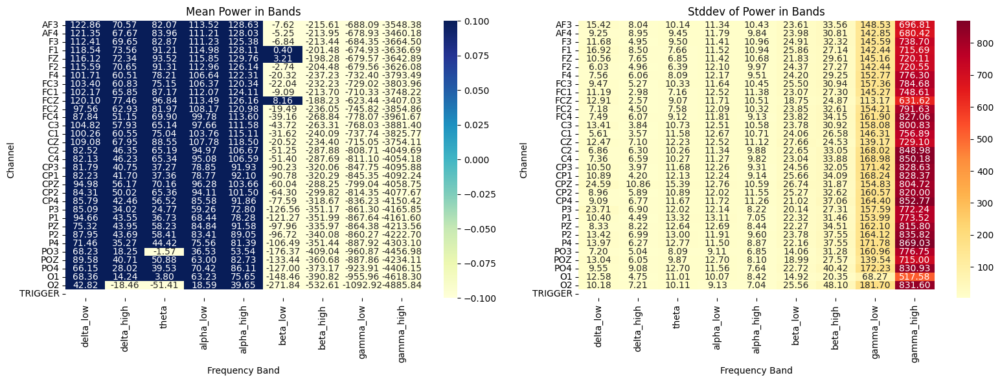

In [47]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

def plot_power_band_heatmaps(feature_powers, frequency_bands):
    channels = list(feature_powers.keys())
    bands = list(frequency_bands.keys())
    n_channels = len(channels)
    n_bands = len(bands)

    # Prepare matrices
    means = np.zeros((n_channels, n_bands))
    stds = np.zeros((n_channels, n_bands))

    for i, channel in enumerate(channels):
        for j, band in enumerate(bands):
            mean, std = feature_powers[channel][band]
            means[i, j] = mean
            stds[i, j] = std

    fig, axes = plt.subplots(1, 2, figsize=(16, 6))

    # Mean heatmap
    sns.heatmap(means, annot=True, fmt=".2f", cmap="YlGnBu", 
                xticklabels=bands, yticklabels=channels, ax=axes[0])
    axes[0].set_title("Mean Power in Bands")
    axes[0].set_xlabel("Frequency Band")
    axes[0].set_ylabel("Channel")

    # Stddev heatmap
    sns.heatmap(stds, annot=True, fmt=".2f", cmap="YlOrRd", 
                xticklabels=bands, yticklabels=channels, ax=axes[1])
    axes[1].set_title("Stddev of Power in Bands")
    axes[1].set_xlabel("Frequency Band")
    axes[1].set_ylabel("Channel")

    plt.tight_layout()
    plt.show()

# Usage:
plot_power_band_heatmaps(meditation_powers_pre, frequency_bands)

In [48]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

def plot_per_band_heatmaps(feature_powers, frequency_bands, value_type='mean', manual_color_scales=None):
    """
    Plots one heatmap per frequency band, each with its own color scale and colorbar.
    Returns a dictionary mapping each band to its (vmin, vmax) color scale.
    value_type: 'mean' or 'stddev'
    manual_color_scales: optional dict {band: (vmin, vmax), ...}
    """
    channels = list(feature_powers.keys())
    bands = list(frequency_bands.keys())
    n_channels = len(channels)
    n_bands = len(bands)

    # Prepare data: for each band, collect values for all channels
    data = np.zeros((n_bands, n_channels))
    for i, band in enumerate(bands):
        for j, channel in enumerate(channels):
            mean, std = feature_powers[channel][band]
            value = mean if value_type == 'mean' else std
            if np.isinf(value):
                value = np.nan
            data[i, j] = value

    colormaps = ["YlGnBu", "YlOrRd", "BuPu", "Greens", "Oranges", "Purples", "Blues"]
    fig, axes = plt.subplots(1, n_bands, figsize=(4*n_bands, 6), sharey=True)
    if n_bands == 1:
        axes = [axes]

    # Store color scales
    color_scales = {}

    for i, band in enumerate(bands):
        band_data = data[i, :].reshape(-1, 1)
        # Use manual color scale if provided, else compute from data
        if manual_color_scales and band in manual_color_scales and manual_color_scales[band] is not None:
            vmin, vmax = manual_color_scales[band]
        else:
            vmin = float(np.nanmin(band_data))
            vmax = float(np.nanmax(band_data))
            if np.isnan(vmin) or np.isnan(vmax):
                axes[i].set_visible(False)
                color_scales[band] = (np.nan, np.nan)
                continue
            if vmin == vmax:
                vmin -= 0.01
                vmax += 0.01
        color_scales[band] = (vmin, vmax)
        cmap = colormaps[i % len(colormaps)]
        sns.heatmap(
            band_data,
            annot=True,
            fmt=".2f",
            cmap=cmap,
            vmin=vmin,
            vmax=vmax,
            yticklabels=channels,
            xticklabels=[band],
            ax=axes[i],
            cbar=True,
            cbar_kws={"shrink": 0.7, "label": value_type}
        )
        axes[i].set_title(f"{band.capitalize()} ({value_type})")
        axes[i].set_xlabel("Band")
        if i == 0:
            axes[i].set_ylabel("Channel")
        else:
            axes[i].set_ylabel("")

    plt.tight_layout()
    plt.show()
    return color_scales


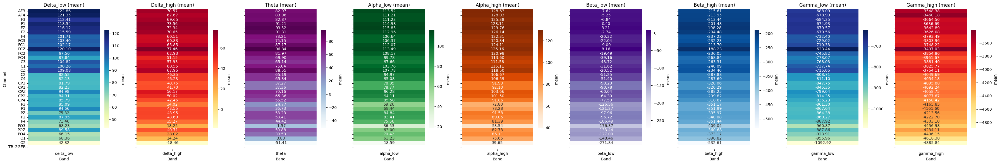

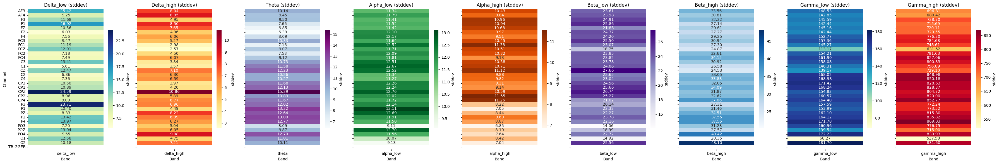

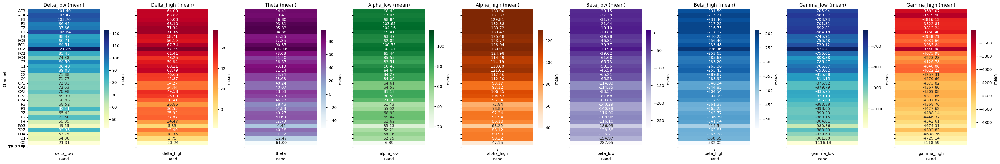

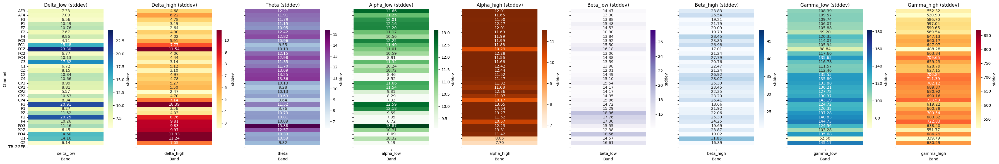

{'delta_low': (5.607904932254704, 24.58734940263425),
 'delta_high': (2.5745026213699806, 10.856929817899474),
 'theta': (6.390497490276851, 15.385149011592128),
 'alpha_low': (9.112779945889066, 13.108662394862483),
 'alpha_high': (6.854218747872804, 11.547957180457681),
 'beta_low': (14.057982980147695, 27.657881756272786),
 'beta_high': (20.35400647572135, 48.1048233061392),
 'gamma_low': (68.27238574653568, 181.6984982315505),
 'gamma_high': (517.5791089453522, 869.0273947130615)}

In [49]:
# Usage:
mean_ranges = plot_per_band_heatmaps(meditation_powers_pre, frequency_bands, value_type='mean')
std_ranges = plot_per_band_heatmaps(meditation_powers_pre, frequency_bands, value_type='stddev')

plot_per_band_heatmaps(meditation_powers_post, frequency_bands, value_type='mean', manual_color_scales=mean_ranges)
plot_per_band_heatmaps(meditation_powers_post, frequency_bands, value_type='stddev', manual_color_scales=std_ranges)

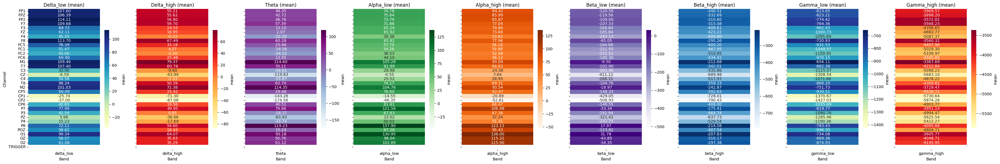

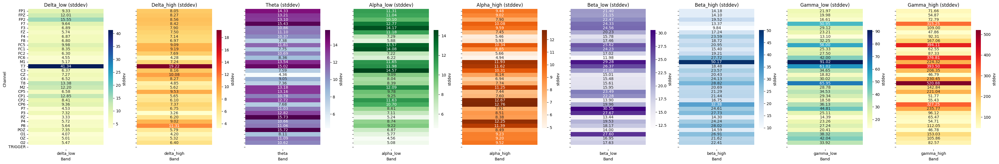

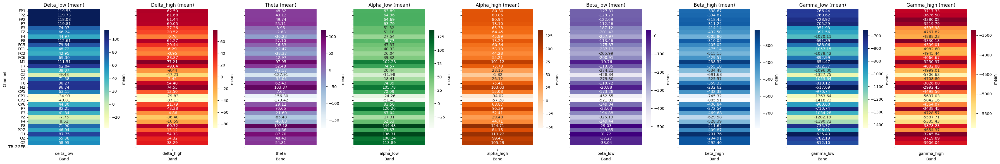

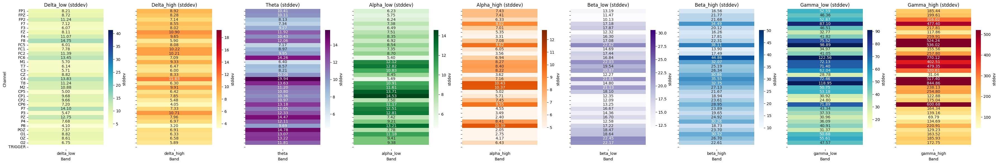

{'delta_low': (3.326438243603992, 41.336015993277826),
 'delta_high': (3.2581843940077175, 19.219981197788364),
 'theta': (4.362828192624823, 15.7318151635969),
 'alpha_low': (4.558003419647611, 14.57368213419675),
 'alpha_high': (4.93698480748512, 12.760552019113009),
 'beta_low': (11.97509711516987, 30.556772593860366),
 'beta_high': (9.837631099081138, 50.16769589637003),
 'gamma_low': (13.10370452166294, 91.02274614880979),
 'gamma_high': (46.77749288899347, 520.875523403505)}

In [50]:
mean_ranges = plot_per_band_heatmaps(tacs_powers_pre, frequency_bands, value_type='mean')
std_ranges = plot_per_band_heatmaps(tacs_powers_pre, frequency_bands, value_type='stddev')

plot_per_band_heatmaps(tacs_powers_post, frequency_bands, value_type='mean', manual_color_scales=mean_ranges)
plot_per_band_heatmaps(tacs_powers_post, frequency_bands, value_type='stddev', manual_color_scales=std_ranges)

/var/folders/72/6g3kz13d2kn7rsgx3thlz_700000gn/T/ipykernel_22712/4096709454.py:37: RuntimeWarning: invalid value encountered in scalar subtract
  mean_diff = mean1 - mean2


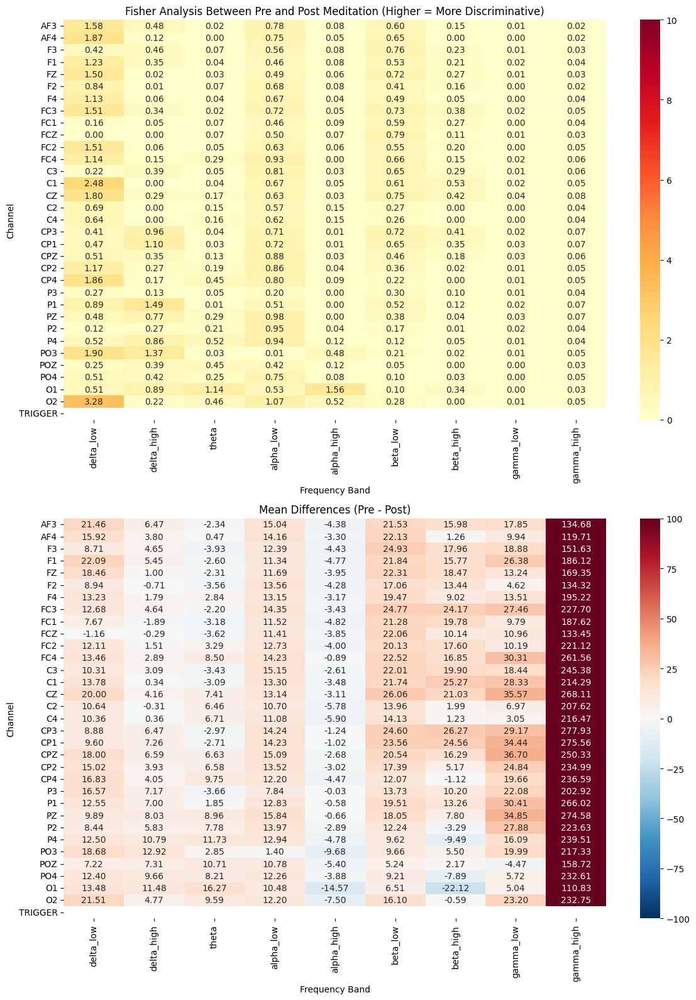

In [51]:
def compute_fisher_scores(feature_powers_1, feature_powers_2, frequency_bands):
    """
    Compute Fisher scores between two feature power objects.
    Fisher score = (μ1 - μ2)^2 / (σ1^2 + σ2^2)
    
    Args:
        feature_powers_1: First feature powers dict (e.g., pre-meditation)
        feature_powers_2: Second feature powers dict (e.g., post-meditation)
        frequency_bands: Dictionary of frequency bands
    
    Returns:
        fisher_scores: Dictionary of fisher scores per channel and band
        means_diff: Dictionary of mean differences
        fisher_heatmap_data: Processed data ready for heatmap plotting
    """
    channels = list(feature_powers_1.keys())
    bands = list(frequency_bands.keys())
    
    # Initialize results dictionaries
    fisher_scores = {}
    means_diff = {}
    
    # Initialize matrix for heatmap
    fisher_matrix = np.zeros((len(channels), len(bands)))
    
    # Compute Fisher scores for each channel and band
    for i, channel in enumerate(channels):
        fisher_scores[channel] = {}
        means_diff[channel] = {}
        
        for j, band in enumerate(bands):
            # Get means and standard deviations
            mean1, std1 = feature_powers_1[channel][band]
            mean2, std2 = feature_powers_2[channel][band]
            
            # Compute mean difference
            mean_diff = mean1 - mean2
            means_diff[channel][band] = mean_diff
            
            # Compute Fisher score
            # Handle potential division by zero or invalid values
            denominator = (std1**2 + std2**2)
            if denominator > 0 and not np.isnan(denominator) and not np.isinf(denominator):
                fisher_score = (mean_diff**2) / denominator
            else:
                fisher_score = np.nan
                
            fisher_scores[channel][band] = fisher_score
            fisher_matrix[i, j] = fisher_score
    
    return fisher_scores, means_diff, fisher_matrix

def plot_fisher_analysis(fisher_matrix, means_diff_matrix, channels, bands, manual_color_scales=None, title_name = None):
    """
    Plot Fisher scores and mean differences as heatmaps
    """
    fig, axes = plt.subplots(2, 1, figsize=(12, 16))
    
    # Fisher scores heatmap
    if manual_color_scales and 'fisher' in manual_color_scales:
        vmin, vmax = manual_color_scales['fisher']
    else:
        vmin, vmax = np.nanmin(fisher_matrix), np.nanmax(fisher_matrix)
    
    sns.heatmap(fisher_matrix, 
                annot=True, 
                fmt=".2f", 
                cmap="YlOrRd",
                xticklabels=bands,
                yticklabels=channels,
                vmin=vmin,
                vmax=vmax,
                ax=axes[0])
    if title_name:
        axes[0].set_title(title_name)
    else:
        axes[0].set_title("Fisher Scores (Higher = More Discriminative)")
    axes[0].set_xlabel("Frequency Band")
    axes[0].set_ylabel("Channel")
    
    # Mean differences heatmap
    if manual_color_scales and 'means_diff' in manual_color_scales:
        vmin, vmax = manual_color_scales['means_diff']
    else:
        vmin, vmax = np.nanmin(means_diff_matrix), np.nanmax(means_diff_matrix)
    
    sns.heatmap(means_diff_matrix,
                annot=True,
                fmt=".2f",
                cmap="RdBu_r",  # Red-Blue diverging colormap
                center=0,       # Center the colormap at 0
                xticklabels=bands,
                yticklabels=channels,
                vmin=vmin,
                vmax=vmax,
                ax=axes[1])
    axes[1].set_title("Mean Differences (Pre - Post)")
    axes[1].set_xlabel("Frequency Band")
    axes[1].set_ylabel("Channel")
    
    plt.tight_layout()
    plt.show()

# Example usage:
def analyze_power_differences(feature_powers_1, feature_powers_2, frequency_bands, manual_color_scales=None, title_name = None):
    """
    Complete workflow to analyze differences between two feature power objects
    """
    # Compute Fisher scores and mean differences
    fisher_scores, means_diff, fisher_matrix = compute_fisher_scores(
        feature_powers_1, 
        feature_powers_2, 
        frequency_bands
    )
    
    # Prepare means_diff matrix for plotting
    channels = list(feature_powers_1.keys())
    bands = list(frequency_bands.keys())
    means_diff_matrix = np.zeros((len(channels), len(bands)))
    for i, channel in enumerate(channels):
        for j, band in enumerate(bands):
            means_diff_matrix[i, j] = means_diff[channel][band]
    
    # Plot the results
    plot_fisher_analysis(
        fisher_matrix, 
        means_diff_matrix, 
        channels, 
        bands, 
        manual_color_scales,
        title_name
    )
    
    return fisher_scores, means_diff

# Usage example:
fisher_scores, means_diff = analyze_power_differences(
    meditation_powers_pre,
    meditation_powers_post,
    frequency_bands,
    manual_color_scales={'fisher': (0, 10), 'means_diff': (-100, 100)},
    title_name = 'Fisher Analysis Between Pre and Post Meditation (Higher = More Discriminative)'
)

/var/folders/72/6g3kz13d2kn7rsgx3thlz_700000gn/T/ipykernel_22712/4096709454.py:37: RuntimeWarning: invalid value encountered in scalar subtract
  mean_diff = mean1 - mean2


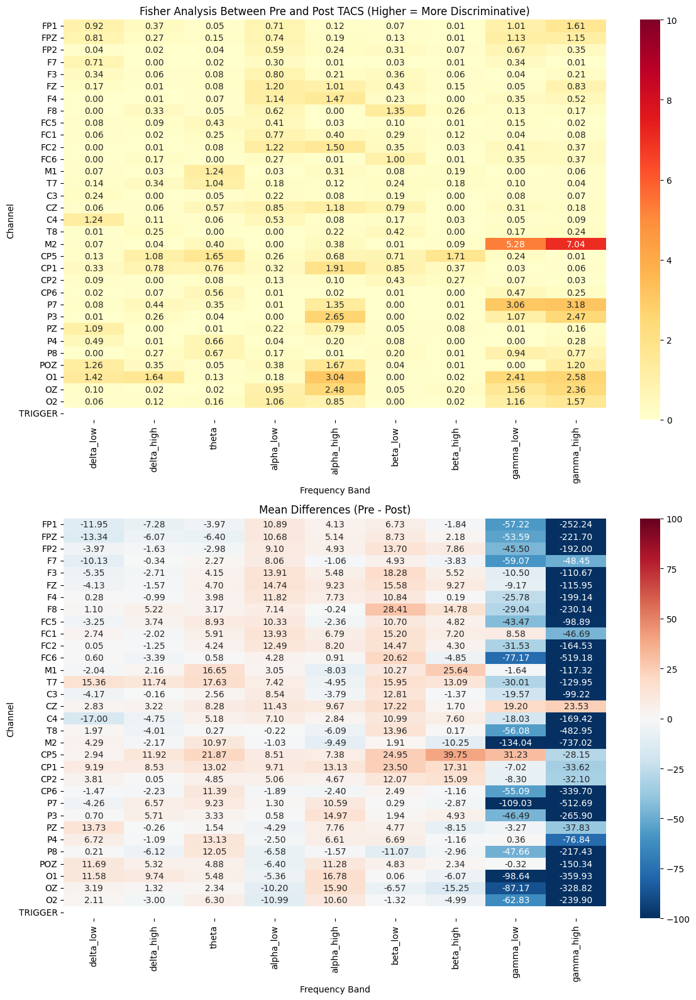

In [52]:
fisher_scores, means_diff = analyze_power_differences(
    tacs_powers_pre,
    tacs_powers_post,
    frequency_bands,
    manual_color_scales={'fisher': (0, 10), 'means_diff': (-100, 100)},
    title_name = 'Fisher Analysis Between Pre and Post TACS (Higher = More Discriminative)'
)